# Application: A Face Detection Pipeline using pyramids, windowing, HOG feature,  SVMs, NMS

This goal of this notebook is to build a face detection system using what would now be considered a classic object detection pipeline from the early 2000s. Many of the core concepts used in this task  


An image classification system (a classifier) takes as  input an image and produces a single class label and a probability associated with the class label prediction.  This class label associated with an image generally characterizes the contents of the entire image, or at least the most dominant, visible contents of the image. Generally,  image classification  can be thought of a one-to-one task, whereby one image is classifier, thereby producing one class label as output. Object detection, on the other hand, not only tells us what is in the image (i.e., class label) but also the location in the image the object is via bounding box (x, y)-coordinates.

In this notebook, we are repurposing an image classifier to perform object detection. In short a  trained image classifier is applied to image patches taken from the image at multiple locations and scales. High scoring  patches/regions of the image are considered detections (i.e., high probabaility of a class of interest). Overlapping detections for a class are reduced to a single region using suppressing technique called non-maxima suppression. 



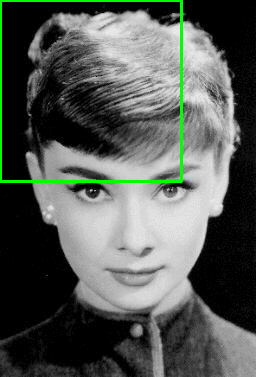

In [344]:
from IPython.display import Image
Image('sliding_window_example.gif', width=300, height=300)

In [349]:
from IPython.display import Image
#Image('hog-16x16-block-normalization.gif', width=300, height=300)

has explored a number of the central concepts and algorithms of machine learning.
But moving from these concepts to real-world application can be a challenge.
Real-world datasets are noisy and heterogeneous, may have missing features, and data may be in a form that is difficult to map to a clean ``[n_samples, n_features]`` matrix.
Before applying any of the methods discussed here, you must first extract these features from your data: there is no formula for how to do this that applies across all domains, and thus this is where you as a data scientist must exercise your own intuition and expertise.

One interesting and compelling application of machine learning is to images, and we have already seen a few examples of this where pixel-level features are used for classification.
In the real world, data is rarely so uniform and simple pixels will not be suitable: this has led to a large literature on *feature extraction* methods for image data (see [Feature Engineering](05.04-Feature-Engineering.ipynb)).

In this section, we will take a look at one such feature extraction technique, the [Histogram of Oriented Gradients](https://en.wikipedia.org/wiki/Histogram_of_oriented_gradients) (HOG), which transforms image pixels into a vector representation that is sensitive to broadly informative image features regardless of confounding factors like illumination.
We will use these features to develop a simple face detection pipeline, using machine learning algorithms and concepts we've seen throughout this chapter. 

We begin with the standard imports:

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

In [2]:
!pip -q install scikit-image

You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


## HOG Features

The Histogram of Gradients is a multistep-step, gradient-based  feature extraction procedure with many exciting applications including  that of identifying pedestrians within images. 


HOG typically is applied to image patches, thereby producing a feature vector that can be input to a SVM to perform classification. More high powered classifiers can be use also.

HOG featurization involves the following steps:

1. Optionally pre-normalize images. This leads to features that resist dependence on variations in illumination.
2. Convolve the image with two filters that are sensitive to horizontal and vertical brightness gradients. These capture edge, contour, and texture information.
3. Subdivide the image into cells of a predetermined size, and compute a histogram of the gradient orientations within each cell.
4. Normalize the histograms in each cell by comparing to the block of neighboring cells. This further suppresses the effect of illumination across the image.
5. Construct a one-dimensional feature vector from the information in each cell.

For a detailed breakdown of HOG see this  [excellent blogpost](https://www.learnopencv.com/histogram-of-oriented-gradients/)

A fast HOG extractor is built into the Scikit-Image project, and we can try it out relatively quickly and visualize the oriented gradients within each cell:

### Download an image to calculate HOG on 

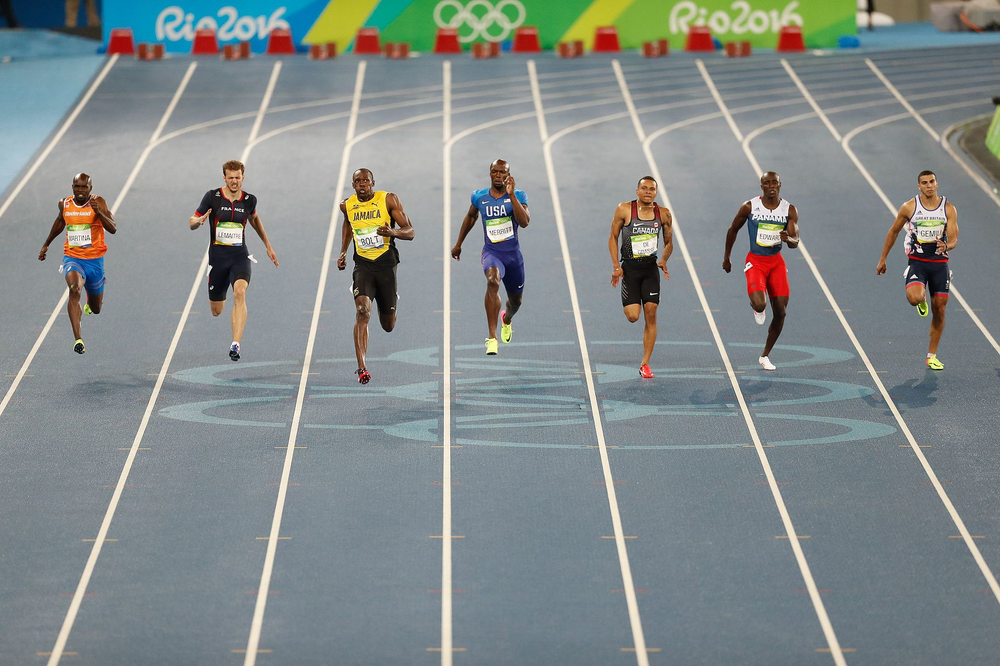

Photo 200M final Rio 2016 by Fernando Frazão/Agência Brasil. It is downloadable from here [here](https://en.wikipedia.org/wiki/Athletics_at_the_2016_Summer_Olympics_%E2%80%93_Men%27s_200_metres#/media/File:Bolt_conquista_tricampeonato_tamb%C3%A9m_nos_200_metros_1038876-18.08.2016_ffz-8057.jpg). 

In [294]:
# Grab the above image By Fernando Frazão/Agência Brasil  from [here](http://agenciabrasil.ebc.com.br/rio-2016/foto/2016-08/bolt-conquista-tricampeonato-tambem-nos-200-metros, CC BY 3.0 br, https://commons.wikimedia.org/w/index.php?curid=50759012)
# and save locally as:  bolt_2016_200meters.jpg
!wget https://www.dropbox.com/s/kh3vhe335y22qb2/Bolt_conquista_tricampeonato_tamb%C3%A9m_nos_200_metros_1038876-18.08.2016_ffz-8057.jpg?dl=0 -O bolt_2016_200meters.jpg

wget: /usr/local/lib/libuuid.so.1: no version information available (required by wget)
Incomplete or invalid multibyte sequence encountered
--2020-07-27 19:20:16--  https://www.dropbox.com/s/kh3vhe335y22qb2/Bolt_conquista_tricampeonato_tamb%C3%A9m_nos_200_metros_1038876-18.08.2016_ffz-8057.jpg?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.7.1, 2620:100:601a:1::a27d:701
Connecting to www.dropbox.com (www.dropbox.com)|162.125.7.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/kh3vhe335y22qb2/Bolt_conquista_tricampeonato_tamb%C3%A9m_nos_200_metros_1038876-18.08.2016_ffz-8057.jpg [following]
Incomplete or invalid multibyte sequence encountered
--2020-07-27 19:20:17--  https://www.dropbox.com/s/raw/kh3vhe335y22qb2/Bolt_conquista_tricampeonato_tamb%C3%A9m_nos_200_metros_1038876-18.08.2016_ffz-8057.jpg
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucfbd671

In [295]:
!ls -l ./bolt_2016_200meters.jpg

-rw-r--r-- 1 root root 4675634 Jul 27 19:20 ./bolt_2016_200meters.jpg


Numpy Array shape (2333, 3500, 3)
image type <class 'numpy.ndarray'> of uint8


[Text(0.5, 1.0, 'Bolt in Rio 200M 2016 (row, col, RGB):(2333, 3500, 3)')]

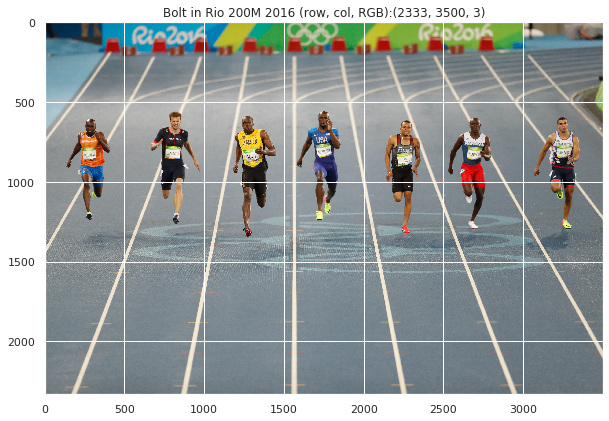

In [300]:
import matplotlib.pyplot as plt
from matplotlib import image
img_name = "bolt_2016_200meters.jpg"
img = image.imread(img_name)         # load image as a numpy array
print(f"Numpy Array shape {img.shape}")
print(f"image type {type(img)} of {img.dtype}")
#plt.imshow(img)                # display numpy array
fig, axs = plt.subplots(1, 1, figsize=(10,10)) 
axs.imshow(img) # visualize an array-like or PIL image
axs.set(title=f'Bolt in Rio 200M 2016 (row, col, RGB):{img.shape}')


Let's use Scikit-Image [Histogram of Oriented Gradients](https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_hog.html)'s feature descriptor as input to  image (patch)  classifier for faces.

<class 'numpy.ndarray'>, (425, 160, 2)


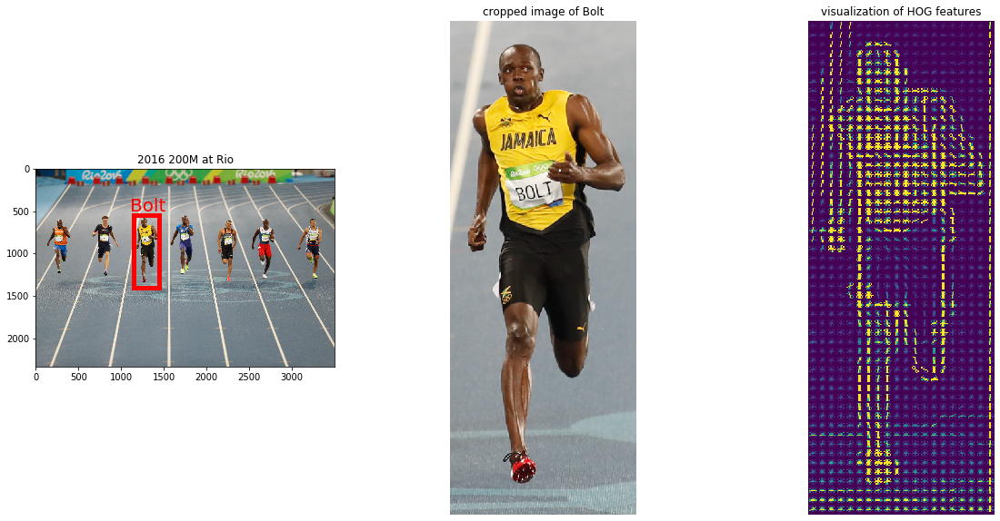

In [3]:
# from skimage import data, color, feature
import skimage.data
from skimage import data, exposure, feature, transform

from scipy import ndimage
import matplotlib.patches as patches

import matplotlib.pyplot as plt
from matplotlib import image
img_name = "bolt_2016_200meters.jpg"
img = image.imread(img_name)         # load image as a numpy array
# crop image
img_cropped = img[550:1400, 1150:1470, :]

image =  ndimage.interpolation.zoom(img_cropped, 0.5) #decimate resolution
print(f"{type(image)}, {image.shape}")
#image = color.rgb2gray(img) #data.chelsea())
hog_vec, hog_image = feature.hog(image, visualize=True)
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

fig, axs = plt.subplots(1, 3, figsize=(20, 10) ) #,subplot_kw=dict(xticks=[], yticks=[]))
axs[0].imshow(img, cmap='gray')
axs[0].set_title('2016 200M at Rio')

axs[1].imshow(img_cropped);  axs[1].axis('off') 
axs[1].set_title('cropped image of Bolt');
axs[2].imshow(hog_image_rescaled);  axs[1].axis('off');  axs[2].axis('off') 
axs[2].set_title('visualization of HOG features');

style = dict(size=20, color='red')
axs[0].text(1100, 500,  "Bolt", **style)
# Create a Rectangle patch
rect = patches.Rectangle((1150, 550),1450-1150, 1400-550, linewidth=5,edgecolor='r',facecolor='none')
# Add the patch to the Axes
axs[0].add_patch(rect)



## HOG in Action: A Simple Face Detector

Using these HOG features, we can build up a simple facial detection algorithm with any machine learning classication algorithm; here we will use a linear support vector machine.
The training steps are as follows:

* Build a training data set
  * Obtain a set of image thumbnails of faces to constitute "positive" training samples.
  * Obtain a set of image thumbnails of non-faces to constitute "negative" training samples.
* Featurize the image data: Extract HOG features from these training samples.
* Train a linear SVM classifier on these positive and negative face examples.

For prediction the following steps can used to detect faces:
* For an "unknown" image, pass a sliding window across the image, extract an image patch, extract HOG features for the patch, classify patch using the trained model to evaluate whether that patch contains a face or not.
* Use non-maxima suppression to suppress face detections that overlap.



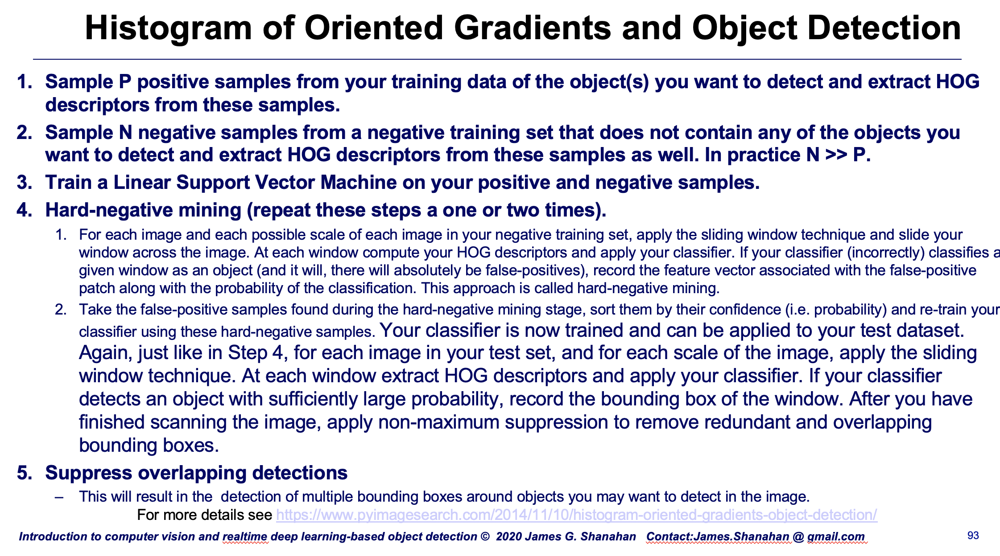

## Build a training data set

### Obtain a set of positive training examples for faces

Let's start by finding some positive training samples that show a variety of faces.
We have one easy set of data to work with—the Labeled Faces in the Wild dataset, which can be downloaded by Scikit-Learn:

In [46]:
from sklearn.datasets import fetch_lfw_people
faces = fetch_lfw_people()
positive_patches = faces.images
print(f"faces shape is {positive_patches.shape}")
print(f"X_train_images min,max: {faces.images.min()}, {faces.images.max():_}")


faces shape is (13233, 62, 47)
X_train_images min,max: 0.0, 255.0


faces reshape is (13233, 64, 64)


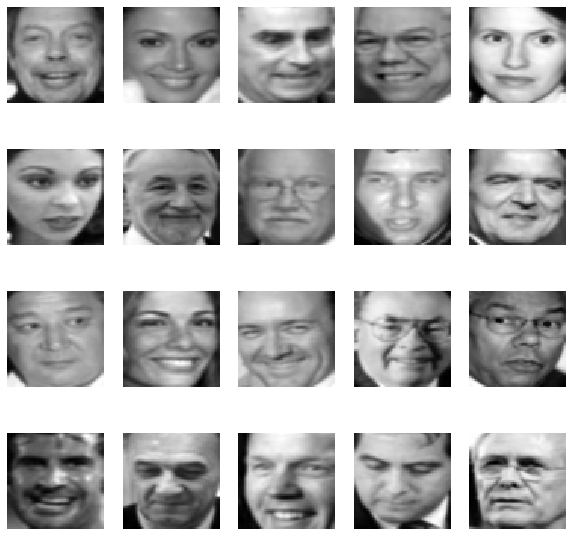

In [13]:
# from skimage import data, color, feature
import skimage.data
from skimage import data, exposure, feature, transform
import numpy as np
window_size=[64, 64] #resize faces to be 64x64; so aspect ratios will change; not the best thing to do but...
positive_patches = np.array([transform.resize(patch, window_size) for patch in positive_patches])
print(f"faces reshape is {positive_patches.shape}")

fig, ax = plt.subplots(4, 5, figsize=(10, 10))
for i, axi in enumerate(ax.flat):
    axi.imshow(positive_patches[100 * i], cmap='gray')
    axi.axis('off')
    
    

In [3]:
from sklearn.datasets import fetch_lfw_people
import skimage.data
from skimage import data, exposure, feature, transform, color
import numpy as np
from sklearn.feature_extraction.image import PatchExtractor

def generate_face_dataset():
    """ Generate positve and negative example faces to train a face classifier"""
    
    # Positive examples
    faces = fetch_lfw_people()
    window_size=[64, 64] #resize faces to be 64x64; so aspect ratios will change; not the best thing to do but...
    positive_patches = np.array([transform.resize(patch, window_size) for patch in faces.images])
    print(f"positive_patches shape is {positive_patches.shape}")
    print(f"positive_patches min,max: {positive_patches.min()}, {positive_patches.max():_}")


    # generate negative  examples
    imgs_to_use = ['camera', "checkerboard", 'chelsea',  'chelsea', 'coffee', 'coins', "colorwheel",  'clock', 
                  "gravel", "horse",  'hubble_deep_field','immunohistochemistry', 
                 'moon',   'page', "rocket", "retina", 'text', "shepp_logan_phantom", "camera", "camera" ]

    images = [color.rgb2gray(getattr(data, name)())  for name in imgs_to_use]

    def extract_patches(img, N, scale=1.0, patch_size=window_size):
        extracted_patch_size = tuple((scale * np.array(window_size)).astype(int))
        extractor = PatchExtractor(patch_size=extracted_patch_size,
                                   max_patches=N, random_state=0)
        patches = extractor.transform(img[np.newaxis])
        if scale != 1:
            patches = np.array([transform.resize(patch, patch_size)
                                for patch in patches])
        return patches

    negative_patches = np.vstack([extract_patches(im, 500, scale)
                                  for im in images for scale in [0.5, 1.0, 2.0]])
    X_train_images = np.r_[positive_patches, negative_patches]
    y_train_images = np.zeros(X_train_images.shape[0])  #true for face; 0 for not face
    y_train_images[:positive_patches.shape[0]] = 1

    print(f"shape of X_train_images training patches training set: {X_train_images.shape}")
    print(f"X_train_images min,max: {X_train_images.min()}, {X_train_images.max():_}")
    return X_train_images, y_train_images

X_train_images, y_train_images = generate_face_dataset()

positive_patches shape is (13233, 64, 64)
positive_patches min,max: 0.0, 255.0


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:23: FutureWarning: The behavior of rgb2gray will change in scikit-image 0.19. Currently, rgb2gray allows 2D grayscale image to be passed as inputs and leaves them unmodified as outputs. Starting from version 0.19, 2D arrays will be treated as 1D images with 3 channels.


shape of X_train_images training patches training set: (43233, 64, 64)
X_train_images min,max: 0.0, 255.0


### Negative training example mining from a patches (at different scales) of built-in Scikit-Image images

Next we need a set of similarly sized thumbnails which *do not* have a face in them.
One way to do this is to take any corpus of input images, and extract, possibly,  multiple thumbnails patches from each negative example.
Here we can use some of the images shipped with Scikit-Image, along with Scikit-Learn's `PatchExtractor`:

X_train_images min,max: 0, 255


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: The behavior of rgb2gray will change in scikit-image 0.19. Currently, rgb2gray allows 2D grayscale image to be passed as inputs and leaves them unmodified as outputs. Starting from version 0.19, 2D arrays will be treated as 1D images with 3 channels.
  


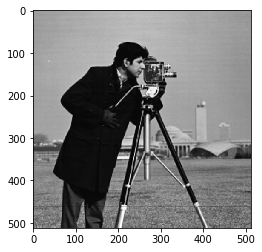

In [49]:
from skimage import data, transform, color
camera_img = color.rgb2gray(getattr(data, 'camera')()) 
plt.imshow(camera_img, cmap="gray")
#dir(data)
print(f"X_train_images min,max: {camera_img.min()}, {camera_img.max():_}")


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:6: FutureWarning: The behavior of rgb2gray will change in scikit-image 0.19. Currently, rgb2gray allows 2D grayscale image to be passed as inputs and leaves them unmodified as outputs. Starting from version 0.19, 2D arrays will be treated as 1D images with 3 channels.
  


patches from 20 SKImage images will be used as negative examples


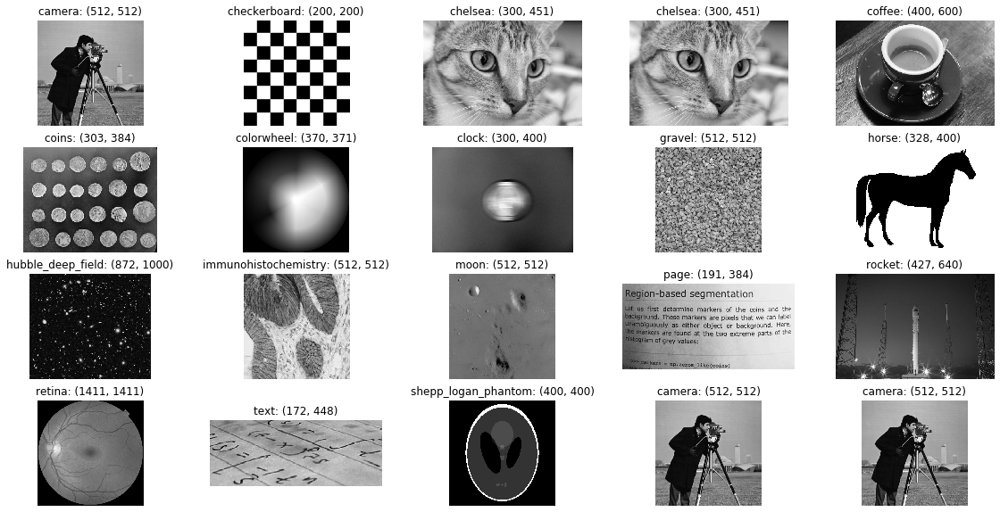

In [14]:
from skimage import data, transform, color

imgs_to_use = ['camera', "checkerboard", 'chelsea',  'chelsea', 'coffee', 'coins', "colorwheel",  'clock', 
              "gravel", "horse",  'hubble_deep_field','immunohistochemistry', 
             'moon',   'page', "rocket", "retina", 'text', "shepp_logan_phantom", "camera", "camera" ]
images = [color.rgb2gray(getattr(data, name)())  for name in imgs_to_use]
row_cnt =  1+(len(images)//5)
if len(images) % 5 ==0:
    row_cnt = len(images)//5
fig, ax = plt.subplots(row_cnt, 5, figsize=(20, 10))
for i, axi in enumerate(ax.flat):
    if i < len(images): 
        axi.imshow(images[i], cmap="gray")
        axi.axis('off')
        axi.set(title = f"{imgs_to_use[i]}: {images[i].shape}")

print(f"patches from {len(images)} SKImage images will be used as negative examples")

#### Generate 30,000 negative examples: 

Generate 30,000 negative examples:, by extracting 1,000 patches from each of the 10 sample images at 3  scales

In [52]:
from sklearn.feature_extraction.image import PatchExtractor

def extract_patches(img, N, scale=1.0, patch_size=window_size):
    extracted_patch_size = tuple((scale * np.array(window_size)).astype(int))
    extractor = PatchExtractor(patch_size=extracted_patch_size,
                               max_patches=N, random_state=0)
    patches = extractor.transform(img[np.newaxis])
    if scale != 1:
        patches = np.array([transform.resize(patch, patch_size)
                            for patch in patches])
    return patches

negative_patches = np.vstack([extract_patches(im, 500, scale)
                              for im in images for scale in [0.5, 1.0, 2.0]])
print(f"shape of negative training patches training set: {negative_patches.shape}")


shape of negative training patches training set: (30000, 64, 64)


In [54]:
print(f"negative_patches min,max: {negative_patches.min()}, {negative_patches.max():_}")


negative_patches min,max: 0.0, 255.0


We now have 30,000 suitable image patches which do not contain faces.
Let's take a look at a few of them to get an idea of what they look like:

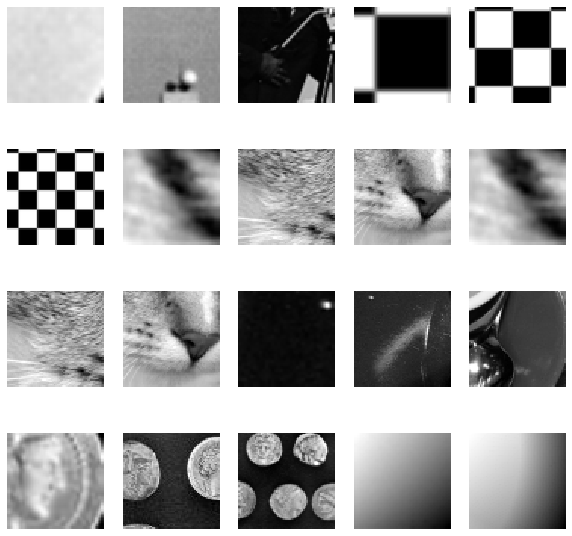

In [65]:
fig, ax = plt.subplots(4, 5, figsize=(10, 10))
for i, axi in enumerate(ax.flat):
    axi.imshow(negative_patches[500 * i], cmap='gray')
    axi.axis('off')

These negative examples will hopefully be representative of the space of "non-faces" such that the image classifier can learn a face classifier accurately.

## Extract HOG features from each training image

Now that we have these positive samples and negative example images, lets form an training dataset by  combining them,  and then computing HOG features for each training image example.


In [ ]:
from itertools import chain
#extract HOG feature vectors
X_train = np.array([feature.hog(im) for im in chain(positive_patches, negative_patches)])
y_train = np.zeros(X_train.shape[0])  #true for face; 0 for not face
y_train[:positive_patches.shape[0]] = 1
y_train_images = y_train
print(f"X_train.shape: {X_train.shape}")

In [53]:
X_train.shape

(43233, 2916)

The leads to over 43,000 training samples, where each image is reduced to a 2,916 length vector, that can fed into a classifier training algorithm.

## Train a probabilistic support vector machine classifier

Next we explore training Linear support vector machine on this high dimensional HOG featurized  thumbnail patches. This can be accomplished via Scikit-Learn's `LinearSVC`, because in comparison to `SVC` it often has better scaling for large number of samples. To learn a linear SVM let's optimize the mixing coefficient for the regularization term, `C`, using  a grid search over a few choices of the `C` parameter:


In [7]:
import numpy as np
xx = np.arange(40).reshape(2, 5,4) #2 gray scale images of 5x4
print (xx)
np.expand_dims(xx, 3) # color channel

[[[ 0  1  2  3]
  [ 4  5  6  7]
  [ 8  9 10 11]
  [12 13 14 15]
  [16 17 18 19]]

 [[20 21 22 23]
  [24 25 26 27]
  [28 29 30 31]
  [32 33 34 35]
  [36 37 38 39]]]


array([[[[ 0],
         [ 1],
         [ 2],
         [ 3]],

        [[ 4],
         [ 5],
         [ 6],
         [ 7]],

        [[ 8],
         [ 9],
         [10],
         [11]],

        [[12],
         [13],
         [14],
         [15]],

        [[16],
         [17],
         [18],
         [19]]],


       [[[20],
         [21],
         [22],
         [23]],

        [[24],
         [25],
         [26],
         [27]],

        [[28],
         [29],
         [30],
         [31]],

        [[32],
         [33],
         [34],
         [35]],

        [[36],
         [37],
         [38],
         [39]]]])

In [17]:
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.calibration import CalibratedClassifierCV


# Generate positive and negative face image  data
# and generate corresponding HOG feature for each positive and negative image
X_train_images, y_train_images = generate_face_dataset()
from itertools import chain
#extract HOG feature vectors
X_train = np.array([feature.hog(im) for im in X_train_images])
y_train = np.zeros(X_train.shape[0])  #true for face; 0 for not face
y_train[:positive_patches.shape[0]] = 1
#JGS TODO test

def train_linear_prob_SVM(X_train, y_train):
    """Train a linear SVM model estimator and re-train it on the full dataset to
    output probabilities as we will use them in the final step of the face detection pipeline (as part of the NMS step)"""
    grid = GridSearchCV(LinearSVC(), {'C': [1.0, 2.0, 4.0, 8.0]})
    grid.fit(X_train, y_train)
    print(f"The accurary of the best linear SVM is :{100*grid.best_score_:.2}%")
    print(f"The optimal hyperparameters is {grid.best_params_}")
    model_svc = grid.best_estimator_
    model = CalibratedClassifierCV(model_svc) 
    model.fit(X_train, y_train)
    #pred_class = model.predict(y_test)
    #probability = model.predict_proba(predict_vec)
    return model

model = train_linear_prob_SVM(X_train, y_train)

/usr/local/lib/python3.6/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/usr/local/lib/python3.6/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/usr/local/lib/python3.6/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/usr/local/lib/python3.6/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/usr/local/lib/python3.6/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarn

0.9904701992705863

In [18]:
grid.best_params_

{'C': 1.0}

Let's take the best estimator and re-train it on the full dataset to output probabilities as we will use them in the final step of the face detection pipeline (as part of the the :

In [19]:
from sklearn.calibration import CalibratedClassifierCV

model_svc = grid.best_estimator_
model = CalibratedClassifierCV(model_svc) 
model.fit(X_train, y_train)
#pred_class = model.predict(y_test)
#probability = model.predict_proba(predict_vec)

CalibratedClassifierCV(base_estimator=LinearSVC(C=1.0, class_weight=None,
                                                dual=True, fit_intercept=True,
                                                intercept_scaling=1,
                                                loss='squared_hinge',
                                                max_iter=1000,
                                                multi_class='ovr', penalty='l2',
                                                random_state=None, tol=0.0001,
                                                verbose=0),
                       cv=None, method='sigmoid')

## Detect faces in a test image using a sliding windows in conjunction with an SVM face classifier 

The trained  SVM face classifier can now be used to classify image patches as face or not-face. Using a sliding windows approach presented below, patches of a big image can be systematically extracted, HOG-featurized, presented to the SVM face classifier for classifcation.

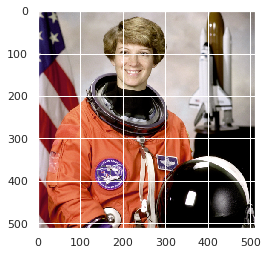

In [20]:
astronaut = test_image = skimage.data.astronaut()  #original image
plt.imshow(test_image)

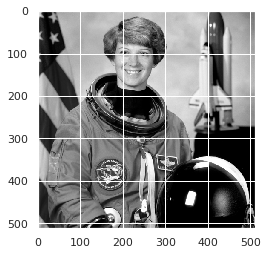

In [21]:
test_image = skimage.data.astronaut()
test_image = skimage.color.rgb2gray(test_image)         # grayscale_img = 0.2125 R + 0.7154 G + 0.0721 B
#test_image = skimage.transform.rescale(test_image, 0.5) # downsample the image to 50% of original size
stride_x, stride_y = positive_patches[0].shape
#test_image = test_image[:160, 40:180]                   # crop the 
#test_image = test_image[:stride_x*3+1, 40:40+stride_y*3+1]                   # crop the 

plt.imshow(test_image, cmap='gray')
#plt.axis('off');

### create and show the image patches, each of which will be classified

In [22]:
#list(range(0, 150 - positive_patches[0].shape[0], 10))
print(test_image.shape[0])
for i in range(0, test_image.shape[0]+1 - 32, 32):
    print(i)

512
0
32
64
96
128
160
192
224
256
288
320
352
384
416
448
480


[Text(0.5, 1.0, 'patch size:64, 64; stride:6, 6')]

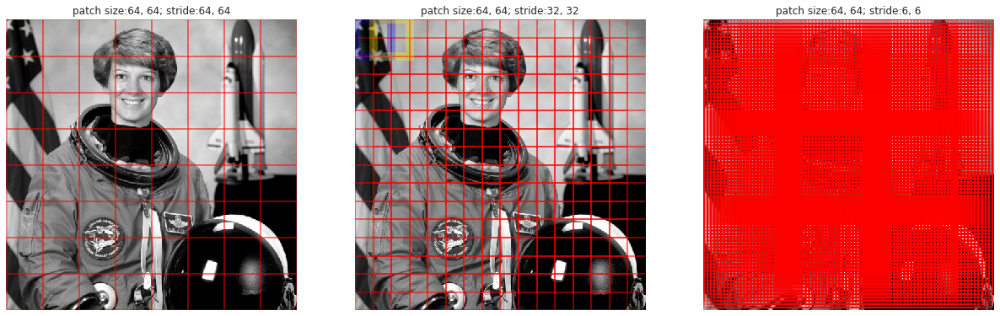

In [533]:
def plot_sliding_window(img, patch_size=positive_patches[0].shape,
                   istep=stride, jstep=stride, scale=1.0, ax=None):
    
    ax.imshow(test_image, cmap='gray')
    ax.axis('off')
    Ni, Nj = (int(scale * s) for s in patch_size)
    for i in range(0, img.shape[0]+1 - Ni, istep):
        for j in range(0, img.shape[1]+1 - Nj, jstep):
            #plt.Rectangle(xy, width, height,...)
            ax.add_patch(plt.Rectangle((j, i), Nj, Ni, edgecolor='red',
                         alpha=0.3, lw=2, facecolor='none'))

            
# plot all images using the matplotlib oop interface
fig, axs = plt.subplots(1, 3, figsize=(21, 7)) 
plot_sliding_window(test_image, patch_size=positive_patches[0].shape,
                    istep=positive_patches[0].shape[0], jstep=positive_patches[0].shape[1], 
                    scale=1.0, ax=axs[0])            
plot_sliding_window(test_image, patch_size=positive_patches[0].shape,
                    istep=int(positive_patches[0].shape[0]*0.5), jstep=int(positive_patches[0].shape[1]*0.5), 
                    scale=1.0, ax=axs[1])
axs[1].add_patch(plt.Rectangle((0,0), 
                           positive_patches[0].shape[1], positive_patches[0].shape[0], edgecolor='blue',
                           alpha=0.3, lw=10, facecolor='none'))
axs[1].add_patch(plt.Rectangle((int(positive_patches[0].shape[1]*0.5),0), 
                           positive_patches[0].shape[1], positive_patches[0].shape[0], edgecolor='yellow',
                           alpha=0.3, lw=10, facecolor='none'))

plot_sliding_window(test_image, patch_size=positive_patches[0].shape,
                    istep=int(positive_patches[0].shape[0]*0.1), jstep=int(positive_patches[0].shape[1]*0.1), 
                    scale=1.0, ax=axs[2])            
axs[0].set(title=f'patch size:{positive_patches[0].shape[0]}, {positive_patches[0].shape[1]}; stride:{positive_patches[0].shape[0]}, {positive_patches[0].shape[1]}')
axs[1].set(title=f'patch size:{positive_patches[0].shape[0]}, {positive_patches[0].shape[1]}; stride:{int(positive_patches[0].shape[0]*.5)}, {int(positive_patches[0].shape[1]*0.5)}')
axs[2].set(title=f'patch size:{positive_patches[0].shape[0]}, {positive_patches[0].shape[1]}; stride:{int(positive_patches[0].shape[0]*.1)}, {int(positive_patches[0].shape[1]*0.1)}')


Next, let's create a window that iterates over patches of this image, and compute HOG features for each patch:

###  Histogram of oriented gradients (HOG) 

#### histogram of oriented gradients (HOG)  
The histogram of oriented gradients (HOG) is a feature descriptor used in computer vision and image processing for the purpose of object detection. The technique counts occurrences of gradient orientation in localized portions of an image. This method is similar to that of edge orientation histograms, scale-invariant feature transform descriptors, and shape contexts, but differs in that it is computed on a dense grid of uniformly spaced cells and uses overlapping local contrast normalization for improved accuracy.

Robert K. McConnell of Wayland Research Inc. first described the concepts behind HOG without using the term HOG in a patent application in 1986. In 1994 the concepts were used by Mitsubishi Electric Research Laboratories. However, usage only became widespread in 2005 when Navneet Dalal and Bill Triggs, researchers for the French National Institute for Research in Computer Science and Automation (INRIA), presented their supplementary work on HOG descriptors at the Conference on Computer Vision and Pattern Recognition (CVPR). In this work they focused on pedestrian detection in static images, although since then they expanded their tests to include human detection in videos, as well as to a variety of common animals and vehicles in static imagery.

For more background on HOG [here](https://en.wikipedia.org/wiki/Histogram_of_oriented_gradients).

Text(0.5, 1.0, 'Histogram of Oriented Gradients')

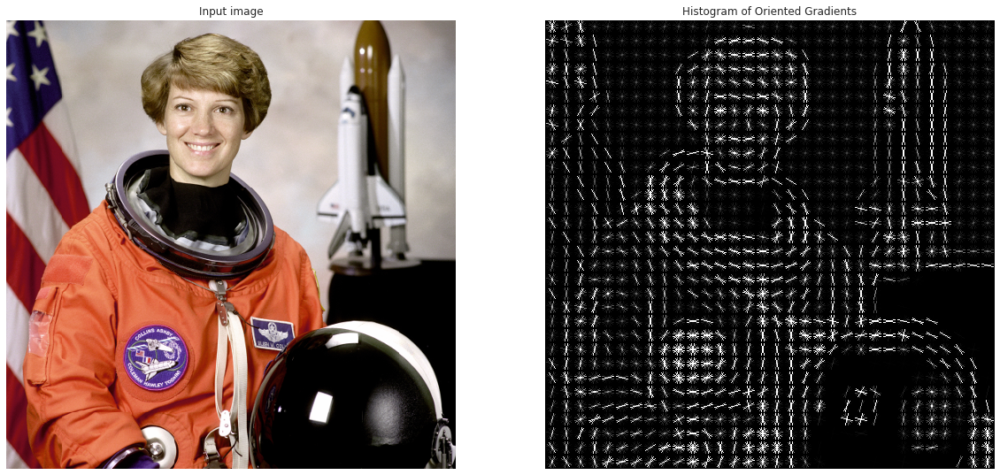

In [564]:
import matplotlib.pyplot as plt

from skimage.feature import hog
from skimage import data, exposure


image = data.astronaut()

fd, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True, multichannel=True)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)

ax1.axis('off')
ax1.imshow(image, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')
#plt.show()

####  Histogram of oriented gradients (HOG) for an image patch

(64, 64)
<class 'numpy.ndarray'>, (64, 64)


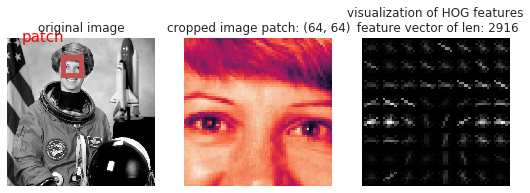

In [565]:
import matplotlib.patches as patches

patch_size = positive_patches[0].shape
print(f"{patch_size}")
img_crop = test_image[patch_size[0]:patch_size[0]*2, patch_size[1]*3:patch_size[1]*4]

print(f"{type(img_crop)}, {img_crop.shape}")
#image = color.rgb2gray(img) #data.chelsea())
hog_vec, hog_image = feature.hog(img_crop, visualize=True)
# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))


fig, axs = plt.subplots(1, 3, figsize=(9, 3) ) #,subplot_kw=dict(xticks=[], yticks=[]))
axs[0].imshow(test_image, cmap='gray'); axs[0].axis('off')
axs[0].set_title('original image')

axs[1].imshow(img_crop);  axs[1].axis('off') 
axs[1].set_title(f'cropped image patch: {patch_size}');axs[1].axis('off');
axs[2].imshow(hog_image_rescaled, cmap="gray");   axs[2].axis('off') 
axs[2].set_title(f'visualization of HOG features\n feature vector of len: {len(hog_vec)}');

style = dict(size=15, color='red')
axs[0].text(47+2, 10+2,  "patch", **style)
# Create a Rectangle patch
rect = axs[0].add_patch(patches.Rectangle((patch_size[1]*3, patch_size[0]),patch_size[1], patch_size[0], linewidth=5,edgecolor='r',facecolor='none'))



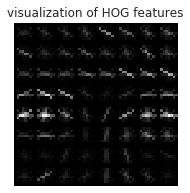

In [567]:
fig, axs = plt.subplots(1, 1, figsize=(3,3) ) #,subplot_kw=dict(xticks=[], yticks=[]))
axs.imshow(hog_image_rescaled, cmap="gray");   axs.axis('off') 
axs.set_title('visualization of HOG features');


In [543]:
astronaut = skimage.data.astronaut()  #original image in channels lasgt format
astronaut[:5, :5]

array([[[154, 147, 151],
        [109, 103, 124],
        [ 63,  58, 102],
        [ 54,  51,  98],
        [ 76,  76, 106]],

       [[177, 171, 171],
        [144, 141, 143],
        [113, 114, 124],
        [106, 107, 120],
        [128, 128, 131]],

       [[201, 194, 193],
        [182, 178, 175],
        [168, 165, 164],
        [159, 157, 157],
        [167, 165, 161]],

       [[220, 213, 210],
        [214, 206, 206],
        [202, 198, 196],
        [197, 191, 193],
        [200, 194, 196]],

       [[232, 223, 223],
        [226, 220, 215],
        [221, 215, 210],
        [215, 210, 206],
        [221, 211, 213]]], dtype=uint8)

### Generating sliding windows, corresponding HOG Features and classify as face, or  not face

In [23]:
def sliding_window(img, patch_size=positive_patches[0].shape,
                   row_step=6, col_step=6):
    height, width = patch_size
    # slide a window across the image 
    for row in range(0, img.shape[0]+1 - height, row_step):
        for col in range(0, img.shape[1]+1 - width, col_step):
            # yield the current window
            yield (row, col), img[row:row + height, col:col + width]
            

In [23]:
indices, patches = zip(*sliding_window(test_image))
# Extract HOG features
patches_hog = np.array([feature.hog(patch) for patch in patches])
print(f"patch size will be {positive_patches[0].shape}")
print(f"Each image patch is transformed into a vector {patches_hog.shape[1]} HOG features")
print(f"This image lead to {patches_hog.shape[0]} patches \ntest cases shape is: {patches_hog.shape}") 

patch size will be (64, 64)
Each image patch is transformed into a vector 2916 HOG features
This image lead to 5625 patches 
test cases shape is: (5625, 2916)


#### Classifiy image  patches that have been converted to HOG-feature vector
Finally, we can take these HOG-featured patches and use our model to evaluate whether each patch contains a face. We see that out of nearly 2,000 patches, we have found tens detections above threshold. The following code also plots the detected candidate  face regions as rectanges. 

[0.96623635 0.99689198 0.99582479 0.98327575 0.95744643 0.9870195
 0.97310432 0.97476078]


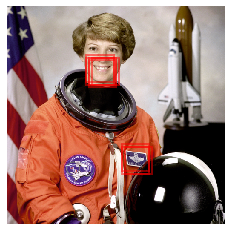

In [48]:
labels = model.predict_proba(patches_hog)
prob_threshold = 0.95
#labels.sum()
#labels= labels.argmax(axis=1)
detected_face_probs = labels[labels[:,1] > prob_threshold, 1]
print(detected_face_probs)
labels= np.where(labels[:,1] > prob_threshold, 1, 0)

detected_faces_upper_left_corners = np.array(indices)[labels == 1]
detected_faces_upper_left_corners = np.append(detected_faces_upper_left_corners, np.expand_dims(detected_faces_upper_left_corners[:,0]+ positive_patches[0].shape[0], 1), 1)
detected_faces_upper_left_corners = np.append(detected_faces_upper_left_corners, np.expand_dims(detected_faces_upper_left_corners[:,1]+ positive_patches[0].shape[1], 1), 1)

fig, ax = plt.subplots()
ax.imshow(skimage.data.astronaut(), cmap='gray')
ax.axis('off')

Ni, Nj = positive_patches[0].shape
indices = np.array(indices)

for i, j in indices[labels == 1]:
    ax.add_patch(plt.Rectangle((j, i), Nj, Ni, edgecolor='red',
                               alpha=0.5, lw=2, facecolor='none'))

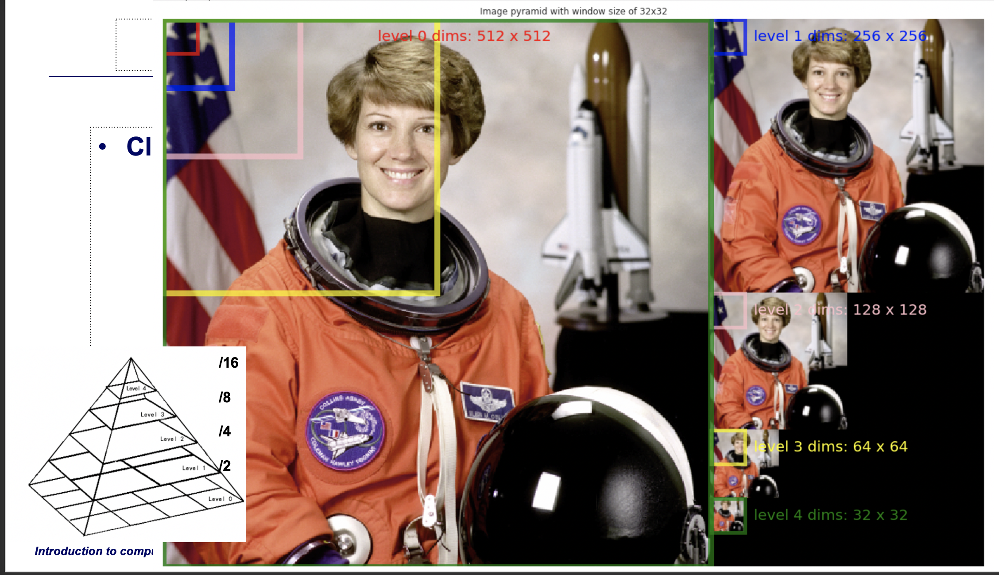

### Non maxima suppression (NMS)
Since there are many overlaping detected face regions,  non maxima suppression (NMS) is used to suppress with a specified overlap degree.

In [11]:
# adopted from https://github.com/jrosebr1/imutils/blob/master/imutils/object_detection.py
import numpy as np
def non_max_suppression(boxes, probs=None, overlapThresh=0.3):
    # if there are no boxes, return an empty list
    if len(boxes) == 0:
        return []

    # if the bounding boxes are integers, convert them to floats -- this
    # is important since we'll be doing a bunch of divisions
    if boxes.dtype.kind == "i":
        boxes = boxes.astype("float")

    # initialize the list of picked indexes
    pick = []

    # grab the coordinates of the bounding boxes
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    # compute the area of the bounding boxes and grab the indexes to sort
    # (in the case that no probabilities are provided, simply sort on the
    # bottom-left y-coordinate)
    area = (x2 - x1 + 1) * (y2 - y1 + 1)
    idxs = y2

    # if probabilities are provided, sort on them instead
    if probs is not None:
        idxs = probs

    # sort the indexes
    idxs = np.argsort(idxs)

    # keep looping while some indexes still remain in the indexes list
    while len(idxs) > 0:
        # grab the last index in the indexes list and add the index value
        # to the list of picked indexes
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)

        # find the largest (x, y) coordinates for the start of the bounding
        # box and the smallest (x, y) coordinates for the end of the bounding
        # box
        xx1 = np.maximum(x1[i], x1[idxs[:last]])
        yy1 = np.maximum(y1[i], y1[idxs[:last]])
        xx2 = np.minimum(x2[i], x2[idxs[:last]])
        yy2 = np.minimum(y2[i], y2[idxs[:last]])

        # compute the width and height of the bounding box
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)

        # compute the ratio of overlap
        overlap = (w * h) / area[idxs[:last]]

        # delete all indexes from the index list that have overlap greater
        # than the provided overlap threshold
        idxs = np.delete(idxs, np.concatenate(([last],
            np.where(overlap > overlapThresh)[0])))

    # return only the bounding boxes that were picked
    return pick, boxes[pick].astype("int")

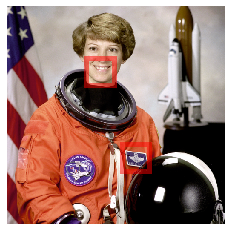

In [50]:
indexes, boxes = non_max_suppression(detected_faces_upper_left_corners, detected_face_probs, overlapThresh=0.3)
detected_faces_upper_left_corners = detected_faces_upper_left_corners[indexes, :2]

fig, ax = plt.subplots()
ax.imshow(skimage.data.astronaut(), cmap='gray')
ax.axis('off')

Ni, Nj = positive_patches[0].shape
indices = np.array(indices)

for i, j in detected_faces_upper_left_corners:
    ax.add_patch(plt.Rectangle((j, i), Nj, Ni, edgecolor='red',
                               alpha=0.5, lw=5, facecolor='none'))

## Build an image pyramid
The pyramid_gaussian function takes an image and yields successive images shrunk by a constant scale factor. Image pyramids are often used, e.g., to implement algorithms for denoising, texture discrimination, and scale-invariant detection. 

Recursively applies the `pyramid_reduce` function to the image, and yields
the downscaled images.

Note that the first image of the pyramid will be the original, unscaled
image. The total number of images is `max_layer + 1`. In case all layers
are computed, the last image is either a one-pixel image or the image where
the reduction does not change its shape.

The following code produces  a pyramid of size 5, where level 0 is the original image, and the remaining levels correspond to four downsampled images of size /2, /4, /8, /16. 
```python
pyramid = tuple(pyramid_gaussian(image, downscale=2, multichannel=True, max_layer=4))
```



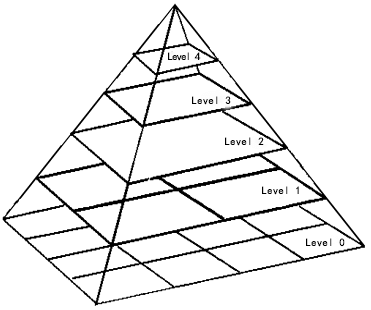

The following code is based on this [example](https://scikit-image.org/docs/dev/auto_examples/transform/plot_pyramid.html#sphx-glr-auto-examples-transform-plot-pyramid-py).

(512, 512, 3)(32, 32, 3)
1(256, 256, 3)
2(128, 128, 3)
3(64, 64, 3)
4(32, 32, 3)
1(256, 256, 3)
2(128, 128, 3)
3(64, 64, 3)
4(32, 32, 3)


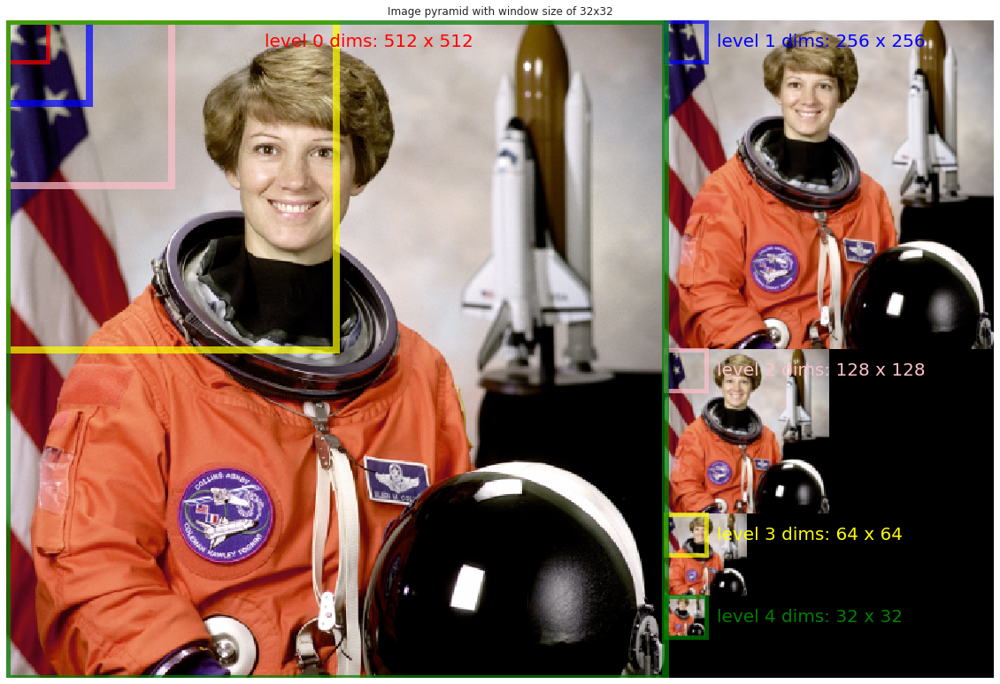

In [445]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import data
from skimage.transform import pyramid_gaussian


image = data.astronaut()
rows, cols, dim = image.shape
pyramid = tuple(pyramid_gaussian(image, downscale=2, multichannel=True, max_layer=4)) 

# stitch the pyramid levels together into one giant image
# init pyramid image to ZEROS
composite_image = np.zeros((rows, cols + cols // 2, 3), dtype=np.double)

#Drop in the level 0 image (i.e., the original image)
composite_image[:rows, :cols, :] = pyramid[0]
print(f"{image.shape}{p.shape}")
i_row = 0
for i, p in enumerate(pyramid[1:]):
    print(f"{i+1}{p.shape}")
    n_rows, n_cols = p.shape[:2]
    composite_image[i_row:i_row + n_rows, cols:cols + n_cols] = p
    i_row += n_rows

fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(composite_image); ax.axis('off')
ax.set_title('Image pyramid with window size of 32x32');


style = dict(size=20)#, color='red')
# annotate pyramid
i_row = 0
col = image.shape[1]
colors=["red", "blue", "pink", "yellow", "green"]
ax.text(0+200, 0+20,  f"level {0} dims: {image.shape[0]} x {image.shape[1]}", **style, color=colors[0])
ax.add_patch(plt.Rectangle((0, 0), 32, 32, edgecolor=colors[0],
                            alpha=0.7, lw=5, facecolor='none'))
for i, p in enumerate(pyramid[1:]):
    print(f"{i+1}{p.shape}")
    n_rows, n_cols = p.shape[:2]
    ax.text(col+40, i_row+20,  f"level {i+1} dims: {n_rows} x {n_cols}", **style, color=colors[i+1])
    ax.add_patch(plt.Rectangle((0, 0), 32*2**(i+1), 32*2**(i+1), edgecolor=colors[i+1],
                            alpha=0.7, lw=8, facecolor='none'))
    ax.add_patch(plt.Rectangle((col, i_row), 32, 32, edgecolor=colors[i+1],
                            alpha=0.7, lw=5, facecolor='none'))
    i_row += n_rows

plt.show()

In [47]:
labels = [1, 3, 2, 5,4]
sorted(labels)[-3:][0]

3

## A face detector from end to end

In [52]:
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns; sns.set()
import numpy as np
from matplotlib  import image
from skimage.feature import hog
from skimage import data, exposure, color
from skimage.transform import pyramid_gaussian

def sliding_window(img, patch_size=[64, 64],  row_step=6, col_step=6):
    height, width = patch_size
    # slide a window across the image 
    for row in range(0, img.shape[0]+1 - height, row_step):
        for col in range(0, img.shape[1]+1 - width, col_step):
            # yield the current window
            yield (row, col), img[row:row + height, col:col + width]
            
# non_max_suppression adopted from https://github.com/jrosebr1/imutils/blob/master/imutils/object_detection.py
def non_max_suppression(boxes, probs=None, overlapThresh=0.3):
    # if there are no boxes, return an empty list
    if len(boxes) == 0:
        return []

    # if the bounding boxes are integers, convert them to floats -- this
    # is important since we'll be doing a bunch of divisions
    if boxes.dtype.kind == "i":
        boxes = boxes.astype("float")

    # initialize the list of picked indexes
    pick = []

    # grab the coordinates of the bounding boxes
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    # compute the area of the bounding boxes and grab the indexes to sort
    # (in the case that no probabilities are provided, simply sort on the
    # bottom-left y-coordinate)
    area = (x2 - x1 + 1) * (y2 - y1 + 1)
    idxs = y2

    # if probabilities are provided, sort on them instead
    if probs is not None:
        idxs = probs

    # sort the indexes
    idxs = np.argsort(idxs)

    # keep looping while some indexes still remain in the indexes list
    while len(idxs) > 0:
        # grab the last index in the indexes list and add the index value
        # to the list of picked indexes
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)

        # find the largest (x, y) coordinates for the start of the bounding
        # box and the smallest (x, y) coordinates for the end of the bounding
        # box
        xx1 = np.maximum(x1[i], x1[idxs[:last]])
        yy1 = np.maximum(y1[i], y1[idxs[:last]])
        xx2 = np.minimum(x2[i], x2[idxs[:last]])
        yy2 = np.minimum(y2[i], y2[idxs[:last]])

        # compute the width and height of the bounding box
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)

        # compute the ratio of overlap
        overlap = (w * h) / area[idxs[:last]]

        # delete all indexes from the index list that have overlap greater
        # than the provided overlap threshold
        idxs = np.delete(idxs, np.concatenate(([last],
            np.where(overlap > overlapThresh)[0])))

    # return only the bounding boxes that were picked
    return pick, boxes[pick].astype("int")            
            
def find_face_regions_img(img, model, prob_threshold = 0.95, patch_size = [64, 64], row_step=6, col_step=6, nms_overlapThresh=0.3, hog_features = True, top_n = -1):
    print(f"Numpy Array shape {img.shape}")
    indices, patches = zip(*sliding_window(img, patch_size=patch_size,row_step=6, col_step=6))
    if hog_features:
        # Extract HOG features
        patches_features= np.array([feature.hog(patch) for patch in patches])
        print(f"This image led to {patches_hog.shape[0]} patches \ntest cases shape is: {patches_features.shape}") 
        labels = model.predict_proba(patches_features)
        labels =  labels[:, 1]
    else:
        patches = np.array(patches).astype("float")/255.0
        patches_features = np.expand_dims(patches, 3) 
        labels = model.predict(patches_features).squeeze()

    if top_n > 0: #select top n ranking bboxes
        prob_threshold = sorted(labels)[-top_n:][0]
    #from IPython.core.debugger import Pdb as pdb;    pdb().set_trace() #breakpoint; dont forget to quit
    print(f"detected {sum(labels >= prob_threshold)} face regions with Pr(face|image_patch) > {prob_threshold}")
    patch_probs = labels[labels >= prob_threshold]
    labels= np.where(labels >= prob_threshold, 1, 0)
    detected_faces_upper_left_corners = np.array(indices)[labels == 1]
    print(f"detected {len(detected_faces_upper_left_corners)} face regions before NMS")
    detected_faces_upper_left_corners = np.append(detected_faces_upper_left_corners, np.expand_dims(detected_faces_upper_left_corners[:,0]+ patch_size[0], 1), 1)
    detected_faces_upper_left_corners = np.append(detected_faces_upper_left_corners, np.expand_dims(detected_faces_upper_left_corners[:,1]+ patch_size[1], 1), 1)
    print(f"detected_faces_bboxes shape is: {detected_faces_upper_left_corners.shape}")
    return np.atleast_2d(detected_faces_upper_left_corners), patch_probs

def find_faces(img_name, model, **kwargs):

    # load image
    img_rgb = img_name #assume is a numpy array if not str
    if type(img_name) is str: 
        img_rgb = image.imread(img_name)
    img = color.rgb2gray(img_rgb)
    detected_faces_bboxes, bbox_probs = find_face_regions_img(img, model, **kwargs) #find  face regions in the original image
    #from IPython.core.debugger import Pdb as pdb;    pdb().set_trace() #breakpoint; dont forget to quit
    pyramid = tuple(pyramid_gaussian(img, downscale=2, multichannel=True, max_layer=3))   #3 levels
    for i, img_at_level in enumerate(pyramid[1:]):
        print(f"{i+1}: {img_at_level.shape}")
        # find faces at this level and rescale them to original image scale
        detected_faces_bboxes_lvl,bbox_probs_lvl = find_face_regions_img(img_at_level, model, **kwargs)
        if detected_faces_bboxes_lvl.shape[0] > 0:  # scale bboxes back to original image scale
            detected_faces_bboxes = np.concatenate((detected_faces_bboxes, detected_faces_bboxes_lvl * (i+2)), axis=0)
            bbox_probs = np.r_[bbox_probs, bbox_probs_lvl]
    if detected_faces_bboxes.shape[0] == 0:
        print("NOTE: no faces found")
        return
    
    indexes, boxes = non_max_suppression(detected_faces_bboxes, bbox_probs, overlapThresh=kwargs["nms_overlapThresh"])
    
    detected_object_bboxes = detected_faces_bboxes[indexes, :]

    height, width = kwargs["patch_size"]
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)

    ax1.imshow(img_rgb); ax1.axis('off')
    ax1.set_title(f'image with {detected_faces_bboxes.shape[0]} detected bboxes before NMS')
    for y, x, y1, x1 in detected_faces_bboxes:
        ax1.add_patch(plt.Rectangle((x, y), y1-y, x1-x, edgecolor='red',
                                   alpha=0.5, lw=5, facecolor='none'))

    ax2.imshow(img_rgb); ax1.axis('off')
    ax2.set_title(f'image with {detected_object_bboxes.shape[0]} object bboxes after NMS')

    for y, x, y1, x1 in detected_object_bboxes:
        ax2.add_patch(plt.Rectangle((x, y), y1-y, x1-x, edgecolor='red',
                                   alpha=0.5, lw=5, facecolor='none'))
        

Numpy Array shape (512, 512)
detected 5 face regions with Pr(face|image_patch) > 3.0864599764868217e-09
detected 5 face regions before NMS
detected_faces_bboxes shape is: (5, 4)
1: (256, 512)
Numpy Array shape (256, 512)
detected 5 face regions with Pr(face|image_patch) > 3.0685922691731093e-09
detected 5 face regions before NMS
detected_faces_bboxes shape is: (5, 4)
2: (128, 512)
Numpy Array shape (128, 512)
detected 5 face regions with Pr(face|image_patch) > 2.9759406050544612e-09
detected 5 face regions before NMS
detected_faces_bboxes shape is: (5, 4)
3: (64, 512)
Numpy Array shape (64, 512)
detected 5 face regions with Pr(face|image_patch) > 2.480939231830348e-09
detected 5 face regions before NMS
detected_faces_bboxes shape is: (5, 4)


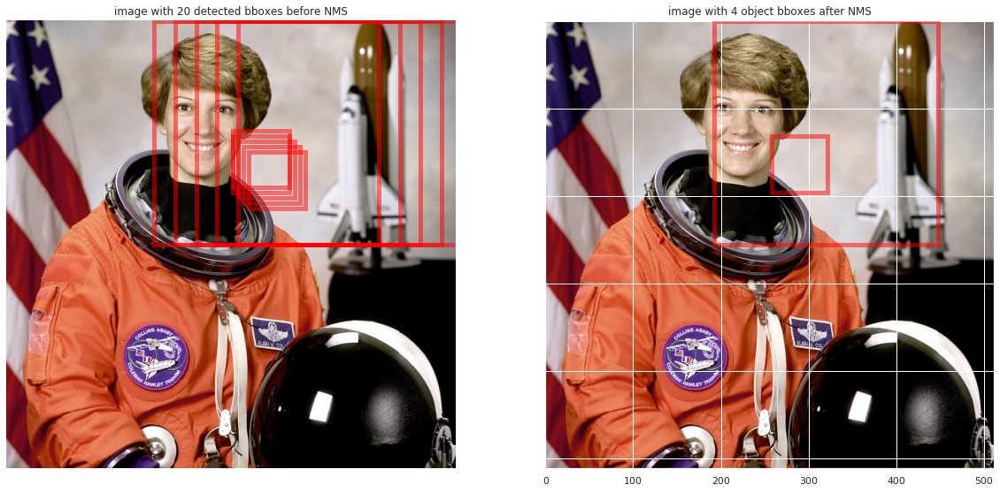

In [53]:
# use a trained CNN classifier
find_faces(data.astronaut(), model, prob_threshold = 0.8, patch_size = [64, 64], row_step=8, col_step=8, nms_overlapThresh=0.3, hog_features=False, top_n=5)


Numpy Array shape (512, 512, 3)
This image led to 5625 patches 
test cases shape is: (5625, 2916)
detected 11 face regions with Pr(face|image_patch) > 0.8
detected 11 face regions before NMS
detected_faces_bboxes shape is: (11, 4)
1(256, 256, 3)
Numpy Array shape (256, 256, 3)
This image led to 1089 patches 
test cases shape is: (1089, 2916)
detected 3 face regions with Pr(face|image_patch) > 0.8
detected 3 face regions before NMS
detected_faces_bboxes shape is: (3, 4)
2(128, 128, 3)
Numpy Array shape (128, 128, 3)
This image led to 121 patches 
test cases shape is: (121, 2916)
detected 0 face regions with Pr(face|image_patch) > 0.8
detected 0 face regions before NMS
detected_faces_bboxes shape is: (0, 4)
3(64, 64, 3)
Numpy Array shape (64, 64, 3)
This image led to 1 patches 
test cases shape is: (1, 2916)
detected 0 face regions with Pr(face|image_patch) > 0.8
detected 0 face regions before NMS
detected_faces_bboxes shape is: (0, 4)


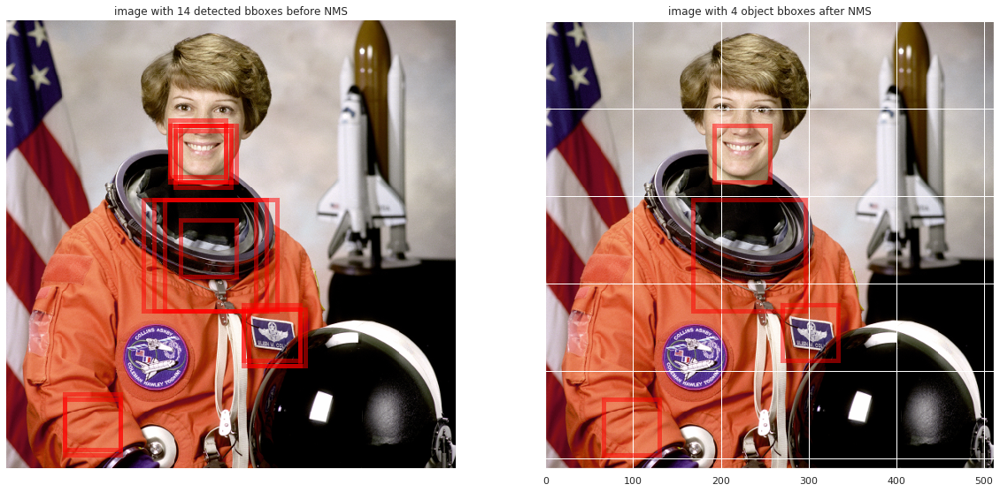

In [52]:
find_faces(data.astronaut(), model, prob_threshold = 0.8, patch_size = [64, 64], row_step=8, col_step=8, nms_overlapThresh=0.3)

Numpy Array shape (540, 960, 3)
This image led to 12000 patches 
test cases shape is: (12000, 2916)
detected 46 face regions with Pr(face|image_patch) > 0.8
detected 46 face regions before NMS
detected_faces_bboxes shape is: (46, 4)
1(270, 480, 3)
Numpy Array shape (270, 480, 3)
This image led to 2450 patches 
test cases shape is: (2450, 2916)
detected 10 face regions with Pr(face|image_patch) > 0.8
detected 10 face regions before NMS
detected_faces_bboxes shape is: (10, 4)
2(135, 240, 3)
Numpy Array shape (135, 240, 3)
This image led to 360 patches 
test cases shape is: (360, 2916)
detected 0 face regions with Pr(face|image_patch) > 0.8
detected 0 face regions before NMS
detected_faces_bboxes shape is: (0, 4)
3(68, 120, 3)
Numpy Array shape (68, 120, 3)
This image led to 10 patches 
test cases shape is: (10, 2916)
detected 0 face regions with Pr(face|image_patch) > 0.8
detected 0 face regions before NMS
detected_faces_bboxes shape is: (0, 4)


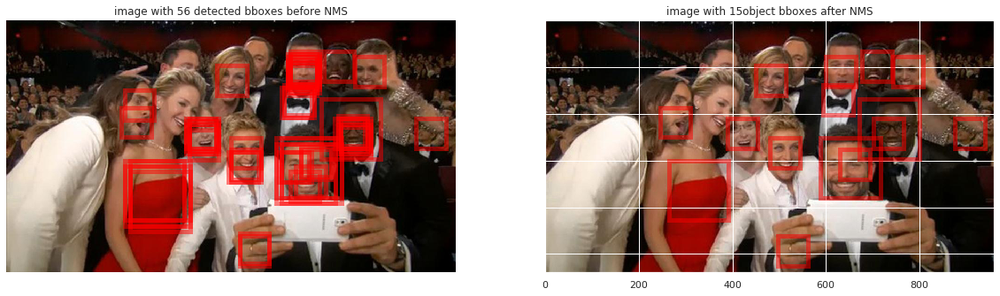

In [51]:

find_faces("Oscar_Samsung_selfie.jpg", model, prob_threshold = 0.8, patch_size = [64, 64], row_step=8, col_step=8, nms_overlapThresh=0.3)


In [247]:
skimage.data.


<module 'skimage.data' from '/usr/local/lib/python3.6/site-packages/skimage/data/__init__.py'>

Face detection is complicated as seen above. The following image also highlights this complexity and how accurately a multistage deep neural network can detect the face region along with other keypoints in the face.

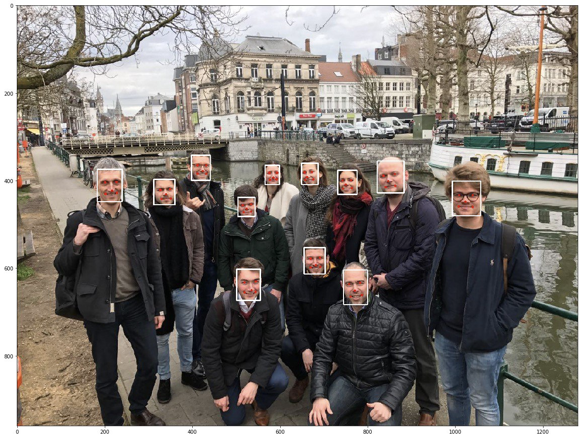

# TASK: Build a better face detecter using a hybrid LeNet-5-style CNN



In [71]:
y_train_images

1

In [4]:
import numpy as np
import pandas as pd

from keras.datasets import mnist
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, MaxPooling2D
from keras.utils.np_utils import to_categorical
from keras import backend as K
from keras.utils.vis_utils import model_to_dot

from IPython.display import SVG

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
%matplotlib inline


X_train_images, y_train_images = generate_face_dataset()
X_train, X_valid, y_train, y_valid = train_test_split(X_train_images, y_train_images, test_size=0.20, random_state=42)
print(f"X_train_images min,max: {X_train_images.min()}, {X_train_images.max():.0}")

X_train = np.expand_dims(X_train, 3) #channels last format for grayscale images
X_valid = np.expand_dims(X_valid, 3) 
X_train /= 255.0
X_valid /= 255.0
print(f"X  train      shape: {X_train.shape}")
print(f"X  validation shape: {X_valid.shape}")

print(f"y  train      dist: class0 class1:  {np.bincount(y_train.astype(int))}")
print(f"y  validation dist: class0 class1:  {np.bincount(y_valid.astype(int))}")

print(f"X_train min,max: {X_train.min()}, {X_train.max()}")
print(f"X_valid min,max: {X_valid.min()}, {X_valid.max()}")

Using TensorFlow backend.


positive_patches shape is (13233, 64, 64)
positive_patches min,max: 0.0, 255.0


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:23: FutureWarning: The behavior of rgb2gray will change in scikit-image 0.19. Currently, rgb2gray allows 2D grayscale image to be passed as inputs and leaves them unmodified as outputs. Starting from version 0.19, 2D arrays will be treated as 1D images with 3 channels.


shape of X_train_images training patches training set: (43233, 64, 64)
X_train_images min,max: 0.0, 255.0
X_train_images min,max: 0.0, 3e+02
X  train      shape: (34586, 64, 64, 1)
X  validation shape: (8647, 64, 64, 1)
y  train      dist: class0 class1:  [24058 10528]
y  validation dist: class0 class1:  [5942 2705]
X_train min,max: 0.0, 1.0
X_valid min,max: 0.0, 1.0


## LeNet-5

Here is my attempt to replicate the LeNet-5 model as closely as possibly the original paper: Yann LeCun, Léon Bottou, Yoshua Bengio, and Patrick Haffner ["Gradient-based learning applied to document recognition"](http://yann.lecun.com/exdb/publis/pdf/lecun-98.pdf).

As few modern neural network libraries allow for partially connected convolution layers, I've substituted this with a dropout layer. I've also replaced Hessian approximated momentum SGD with Adam optimizer.

In [5]:
model = Sequential()

model.add(Convolution2D(filters=6, 
                        kernel_size=(5, 5), 
                        padding="valid", 
                        input_shape = (X_train_images.shape[1], X_train_images.shape[2], 1)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Activation("relu"))

model.add(Convolution2D(filters=16, 
                        kernel_size=(5, 5), 
                        padding="valid"))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Activation("relu"))
model.add(Dropout(0.5))

model.add(Convolution2D(filters=120, 
                        kernel_size=(1, 1), 
                        padding="valid"))

model.add(Flatten())
model.add(Dense(84))
model.add(Activation("relu"))
model.add(Dense(1))
model.add(Activation('sigmoid'))

Training

In [6]:
model.compile(loss="binary_crossentropy", optimizer="Adam", metrics=["accuracy"])
hist = model.fit(X_train, y_train, 
                 batch_size=32, epochs=5, 
                 validation_data=(X_valid, y_valid))

Train on 34586 samples, validate on 8647 samples
Epoch 1/5
34586/34586 [==============================] - 43s 1ms/step - loss: 0.0845 - accuracy: 0.9640 - val_loss: 0.0360 - val_accuracy: 0.9868
Epoch 2/5
34586/34586 [==============================] - 43s 1ms/step - loss: 0.0222 - accuracy: 0.9920 - val_loss: 0.0155 - val_accuracy: 0.9954
Epoch 3/5
34586/34586 [==============================] - 41s 1ms/step - loss: 0.0163 - accuracy: 0.9943 - val_loss: 0.0156 - val_accuracy: 0.9951
Epoch 4/5
34586/34586 [==============================] - 42s 1ms/step - loss: 0.0123 - accuracy: 0.9956 - val_loss: 0.0098 - val_accuracy: 0.9976
Epoch 5/5
34586/34586 [==============================] - 41s 1ms/step - loss: 0.0087 - accuracy: 0.9974 - val_loss: 0.0149 - val_accuracy: 0.9957


## Test learnt face detector 

In [21]:
find_faces(data.astronaut(), model, prob_threshold = 0.8, patch_size = [64, 64], row_step=8, col_step=8, nms_overlapThresh=0.3, hog_features=False)


Numpy Array shape (512, 512, 3)
> <ipython-input-19-609812941aba>(92)find_face_regions_img()
     90     else:
     91         from IPython.core.debugger import Pdb as pdb;    pdb().set_trace() #breakpoint; dont forget to quit
---> 92         patches = patches.astype("float")/255.0
     93         patches_features = np.expand_dims(patches, 3)
     94         labels = model.predict(patches_features)



ipdb>  type(patches)


<class 'tuple'>


ipdb>  q


BdbQuit: 

In [ ]:

find_faces("Oscar_Samsung_selfie.jpg", model, prob_threshold = 0.8, patch_size = [64, 64], row_step=8, col_step=8, nms_overlapThresh=0.3)


In [ ]:
model = Sequential()

model.add(Convolution2D(filters=32, 
                        kernel_size=(3, 3), 
                        padding="valid", 
                        input_shape = (X_train_images.shape[1], X_train_images.shape[2], 1)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Activation("relu"))

model.add(Convolution2D(filters=32, 
                        kernel_size=(3, 3), 
                        padding="valid"))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Activation("relu"))
model.add(Dropout(0.5))

model.add(Convolution2D(filters=32, 
                        kernel_size=(3, 3), 
                        padding="valid"))

model.add(Flatten())
model.add(Dense(84))
model.add(Activation("relu"))
model.add(Dense(1))
model.add(Activation('sigmoid'))

model.compile(loss="binary_crossentropy", optimizer="Adam", metrics=["accuracy"])
hist = model.fit(X_train, y_train, 
                 batch_size=32, epochs=20, 
                 validation_data=(X_valid, y_valid))

In [ ]:
# Build a better face detecter using a fully convolutional network (FCN) 

# Caveats and Improvements

If you dig a bit deeper into the preceding code and examples, you'll see that we still have a bit of work before we can claim a production-ready face detector.
There are several issues with what we've done, and several improvements that could be made. In particular:

### Our training set, especially for negative features, is not very complete

The central issue is that there are many face-like textures that are not in the training set, and so our current model is very prone to false positives.
You can see this if you try out the above algorithm on the *full* astronaut image: the current model leads to many false detections in other regions of the image.

We might imagine addressing this by adding a wider variety of images to the negative training set, and this would probably yield some improvement.
Another way to address this is to use a more directed approach, such as *hard negative mining*.
In hard negative mining, we take a new set of images that our classifier has not seen, find all the patches representing false positives, and explicitly add them as negative instances in the training set before re-training the classifier.



# References
Jake VanderPlas' [Python Data Science Handbook](http://shop.oreilly.com/product/0636920034919.do) provided a lot of inspiration for this notebook. This is an excellent  resource on all aspects of Python.